In [73]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [2]:
!ls

Exercise on Preprocessing.docx VPN.ipynb


In [89]:
df = pd.read_csv('../data/vpn.csv')
df.head()

,user_country,location_selected,protocol,date,time_to_connect,download_speed,latency
0,GB,UK - London,udp,2018-02-06,15.0,58942.0,88.0
1,FR,France - Paris - 1,udp,2018-02-06,61.0,11878.0,528.0
2,GB,UK - London,udp,2018-02-06,52.0,18254.0,322.0
3,GB,UK - London,udp,2018-02-06,21.0,93798.0,38.0
4,GB,UK - London,tcp,2018-02-06,100.0,12048.0,460.0


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   user_country       100000 non-null  object 
 1   location_selected  100000 non-null  object 
 2   protocol           99972 non-null   object 
 3   date               100000 non-null  object 
 4   time_to_connect    99865 non-null   float64
 5   download_speed     99851 non-null   float64
 6   latency            77466 non-null   float64
dtypes: float64(3), object(4)
memory usage: 5.3+ MB


In [6]:
df.describe()

,time_to_connect,download_speed,latency
count,99865.000000,99851.000000,77466.000000
mean,137.027187,44377.239551,326.879947
std,697.982668,37969.777874,4594.842451
min,0.000000,0.000000,0.000000
25%,24.000000,17153.415900,59.000000
50%,40.000000,33734.100000,102.000000
75%,77.000000,60952.478500,199.000000
max,60113.000000,372800.317800,978256.000000


<AxesSubplot:xlabel='protocol', ylabel='count'>

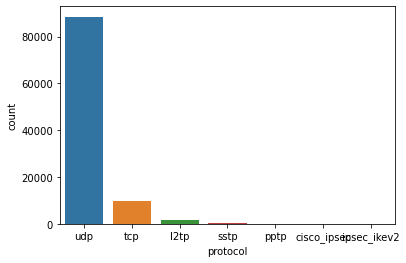

In [13]:
sns.countplot(x="protocol",data=df)

In [15]:
df.groupby('protocol').count()

,user_country,location_selected,date,time_to_connect,download_speed,latency
protocol,,,,,,
cisco_ipsec,11,11,11,11,11,11
ipsec_ikev2,7,7,7,6,6,6
l2tp,1731,1731,1731,1731,1731,1731
pptp,19,19,19,19,19,19
sstp,196,196,196,196,196,196
tcp,9601,9601,9601,9598,9597,8535
udp,88407,88407,88407,88276,88263,66968


In [22]:
df.isnull().sum()

user_country             0
location_selected        0
protocol                28
date                     0
time_to_connect        135
download_speed         149
latency              22534
dtype: int64

In [21]:
df.isnull().sum() / df.count()

user_country         0.000000
location_selected    0.000000
protocol             0.000280
date                 0.000000
time_to_connect      0.001352
download_speed       0.001492
latency              0.290889
dtype: float64

In [14]:
df.groupby('protocol').mean()

,time_to_connect,download_speed,latency
protocol,,,
cisco_ipsec,333.636364,41909.289982,183.727273
ipsec_ikev2,2684.666667,9157.182267,1457.333333
l2tp,81.554015,44162.213609,315.711727
pptp,44.947368,29371.710632,489.684211
sstp,115.591837,43318.724907,536.239796
tcp,184.570536,32206.404105,487.448975
udp,132.679143,45719.405135,305.967567


<AxesSubplot:xlabel='download_speed', ylabel='latency'>

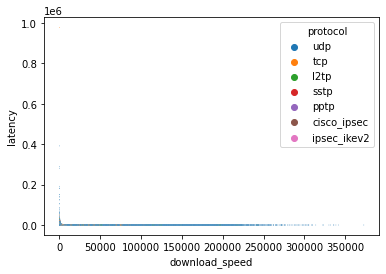

In [9]:
sns.scatterplot(x='download_speed', y='latency', hue='protocol', data=df,s = 0.5)

In [27]:
df.std()

time_to_connect      697.982668
download_speed     37969.777874
latency             4594.842451
dtype: float64

In [ ]:
#detect outliner
df[df['latency'] > df['latency'].mean() + 2.5 * df['latency'].std()]['latency']

#remove outliner
df_ol_lat = 
for col_name in ['lantency','download_spped']:
    df_ol_lat = df[df[col_name] < df[col_name].mean() + 2.5 * df[col_name].std()]


<AxesSubplot:xlabel='download_speed', ylabel='latency'>

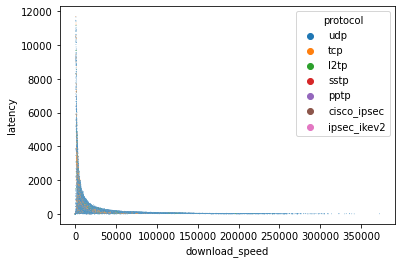

In [33]:
sns.scatterplot(x='download_speed', y='latency', hue='protocol', data=df_ol_lat,s = 0.5)

<AxesSubplot:>

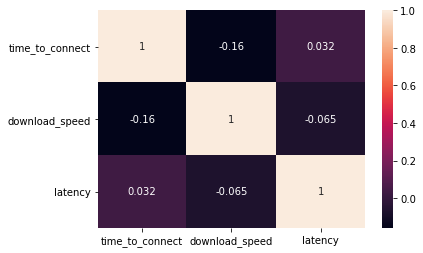

In [19]:
sns.heatmap(df.corr(),annot=True)

In [75]:
df_country = df.groupby('user_country')['latency'].mean()
df_country

user_country
DE    210.922006
FR    418.521683
GB    238.665237
Name: latency, dtype: float64

In [91]:
df[['latency','user_country']].head()

,latency,user_country
0,238.665237,GB
1,418.521683,FR
2,238.665237,GB
3,238.665237,GB
4,238.665237,GB


In [90]:
df['latency'] = [ lat if lat == lat else df_country[country] for lat, country in zip(df['latency'], df['user_country'])]

In [93]:
from  sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="mean")

In [94]:
for coun in df['user_country'].unique():
    print(coun)
    imputer.fit(df[df['user_country'] == coun])
    df[df['user_country'] == coun] = imputer.transform(df[df['user_country'] == coun])

GB


ValueError: Cannot use mean strategy with non-numeric data:
could not convert string to float: 'GB'

In [92]:
df['user_country'].isnull().any()

False

In [69]:
[ df_country[country] if 1 else lat for lat, country in zip(df['latency'], df['user_country'])]

KeyError: 88.0

In [72]:
df['user_country'].unique()

array([  88.,  528.,  322., ..., 1360., 8425., 3626.])

In [71]:
for lat, country in zip(df['latency'], df['user_country']):
    print(country)
    df_country[country] if 1 else lat

88.0


KeyError: 88.0